Implementation - 2018 VAST MC 2

Team Name: CN

Names: Nikhita Ajaykumar, Carolina Navarrete

UT EID: na26274, can2672

Date: 04.11.2023

### Project Objective:

Last year, the Kasios Furniture Company was implicated in environmental damage to the Boonsong Lekagul Wildlife Preserve for both dumping toxic waste and polluting the air with chemicals from its manufacturing process. Kasios denies this accusation. 

Our objective is to take the given hydrology data taken from across the preserve to prove the claim that Kasios is guilty of having contaminated the waterways of BLWP. Our data consist of readings from each sampling station over time for several different chemicals and water properties.

####Import Libraries

In [1]:
# import libraries
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import altair as alt
import seaborn as sns

pd.options.display.max_rows = 9999
print(pd.options.display.max_rows)

9999


####Description of the Dataset

In [2]:
# import dataset
df = pd.read_csv('hydrology.csv')
df

FileNotFoundError: [Errno 2] No such file or directory: 'hydrology.csv'

In [ ]:
df['sample date'] = pd.to_datetime(df['sample date'])
df.dtypes

sample date    datetime64[ns]
location               object
id                      int64
value                 float64
measure                object
unit                   object
dtype: object

### Top/Bottom 30 Chemical Observations

As a way to observe the abundance of chemical oberservations, we plotted the top 30 and bottom 30 of those counts into bar charts that we could analyze. This was done with the intention of observing whether or not there were any significant outliers that would warrant further solo analysis. Given the difference between value counts of the bottom 30 and top 30, we decided to remove the bottom 30 measures as a way to minimize the amount of data we were working with. 

# Interactive Plot #1

In [ ]:
 # Top 30 Chemical Observations 
chems = df['measure']
top_30 = chems.value_counts(ascending = True).nlargest(30)
bottom_30 = chems.value_counts(ascending = True).nsmallest(30)

#Plots
t = px.bar(top_30, x='measure', orientation='h', 
           labels={"measure": "Number of Observations",
                   "index": " "},
           title="Top 30 Chemical Observations",)

t.update_layout(width=850, height=450, bargap=0.50, )
t.update_traces(marker_color='midnightblue')
t.update_xaxes(range = [0,5500])
t

# Interactive Plot #2

In [ ]:
b = px.bar(bottom_30, x = 'measure', orientation='h', 
           labels={"measure": "Number of Observations",
                   "index": ""},
           title="Bottom 30 Chemical Observations",
          )

b.update_layout(width=850, height=450, bargap=0.50, )
b.update_traces(marker_color='midnightblue')
b.update_xaxes(range = [0,150])
b

In [ ]:
# remove bottom 30 measures

measure_counts = df['measure'].value_counts().sort_values()
bottom_30_measures = measure_counts.index[:30]
df = df[~df['measure'].isin(bottom_30_measures)]

## Tick Chart of Measures over Time

Given the reduced data, we know wanted to visualize the range over time in which these measurements were taken and where they were taken from. We did this by creating a tick chart that plotted Measurements over Time, with each region color-coded to provide clarity. With this visualization, we noted that several chemicals lacked recent data, while others indicated of only recent discoveries of specific chemicals at the site. Along with this analysis, it can noted that there are a certain measurements that were taken at almost ever year that would be worth observing to measure if the chemicals increased or decreased over time per location, given the abundance of data provided. Clicking on the legend, you can isolate by location. We can see the some of the locations do not have as many measurements.


# Interactive Plot 3

In [ ]:
alt.data_transformers.disable_max_rows()

# create a legend selection
legend_select = alt.selection_multi(fields=['location'], bind='legend')

chemicals_range = alt.Chart(df).mark_tick().encode(
    x=alt.X('sample date:T', axis=alt.Axis(title='Time')), 
    y='measure', 
    color=alt.Color('location', scale=alt.Scale(scheme='tableau20')),
    tooltip='location',
    opacity=alt.condition(legend_select, alt.value(1), alt.value(0))
).properties(title="Measures over Time").add_selection(legend_select).interactive()

chemicals_range


alt.Chart(...)

### Layered line plot of methysolomine vs time for each of the locations


Methylosmoline is the chemical that Kasios was accused of dumping in the preserve so that is where our focus lied when it came to visualizing any increases or decreases in the measurements found at the sites nearby. To do this, we took all measurements taken of Methylosmoline from 2007-2017 at each location and plotted them against one another in a layered line plot. Our visualization displayed a clear increase in the chemical in the regions of Somchair and Kohsoom. We did not look at Somchair because there was not an equal variance in points, so we thought there was an equal variance of points (it had a sharp increase).

# Interactive Plot #4

In [ ]:
# filter data for Methylosmoline
meth_df = df[(df["measure"] == "Methylosmoline") & 
               (df['sample date'].dt.year >= 2007) & 
               (df['sample date'].dt.year <= 2017)]

# zoom selection
zoom = alt.selection_interval(bind='scales', encodings=['x'])

# create scatter plot

scatter_plot = alt.Chart(meth_df).mark_circle().encode(
    x="sample date:T",
    y="value:Q",
    color=alt.Color("location:N", legend=alt.Legend(title="Location")),
    tooltip=["location", "sample date", alt.Tooltip("value", format=".2f")]
).properties(
    width=700,
    height=400,
    title="Methylosmoline Concentration vs Time by Location"
)

line_plot = alt.Chart(meth_df).mark_line().encode(
    x="sample date:T",
    y="value:Q",
    color=alt.Color("location:N", scale=alt.Scale(scheme='tableau20'), legend=alt.Legend(title="Location")),
    tooltip=["location", "sample date", alt.Tooltip("value", format=".2f")]
).properties(
    width=700,
    height=400,
    title="Methylosmoline Concentration vs Time by Location"
).add_selection(zoom)


both = scatter_plot + line_plot
both

alt.LayerChart(...)

### Measures that predict contamination trend in Kohsoom

Given the sudden rise in the chemical Methylosmoline found in Kohsoom during the time period of the suspected contamination, our team decided to further explore the chemical abundance found during the same period. Below are a list of various chemicals of interest that could indicate contamination. 

# Non-Interactive Plots (6)

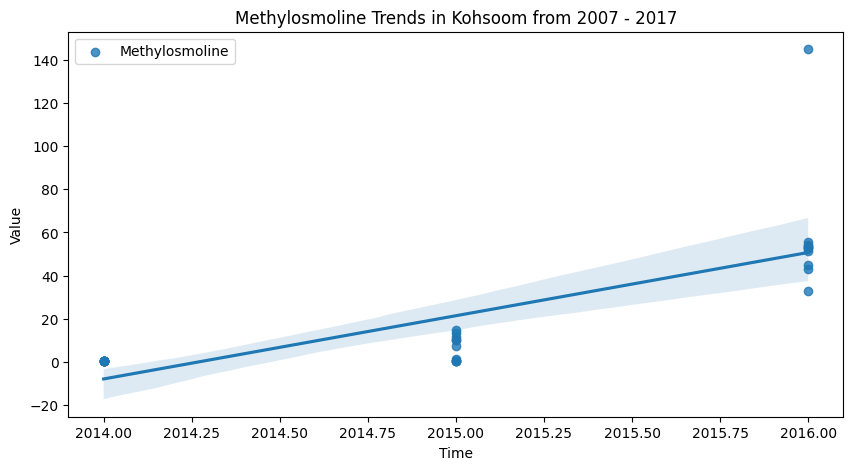

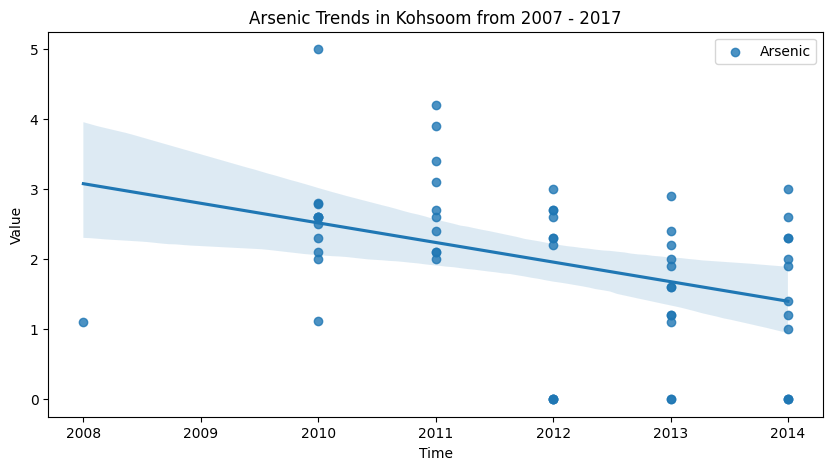

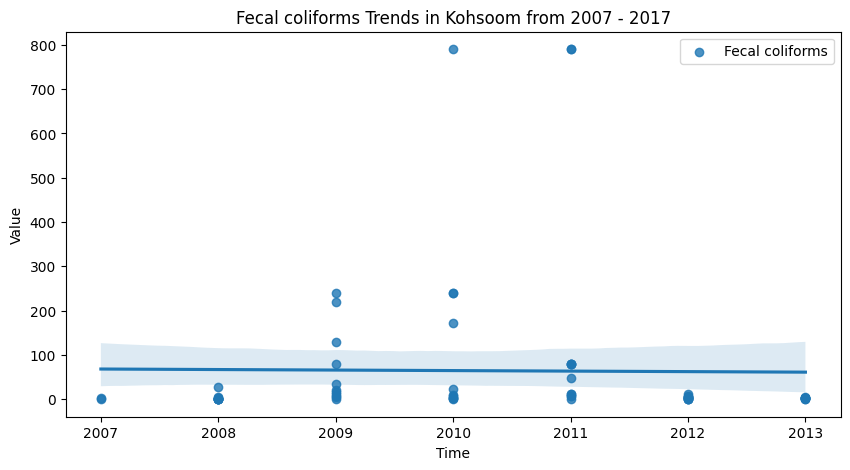

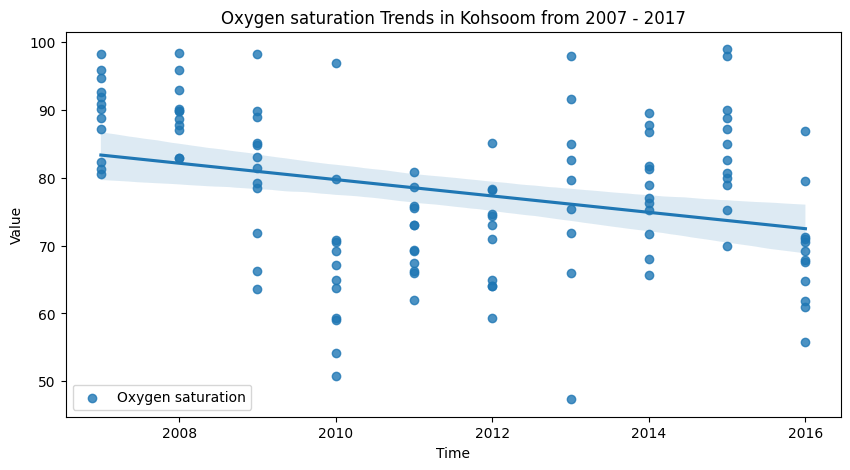

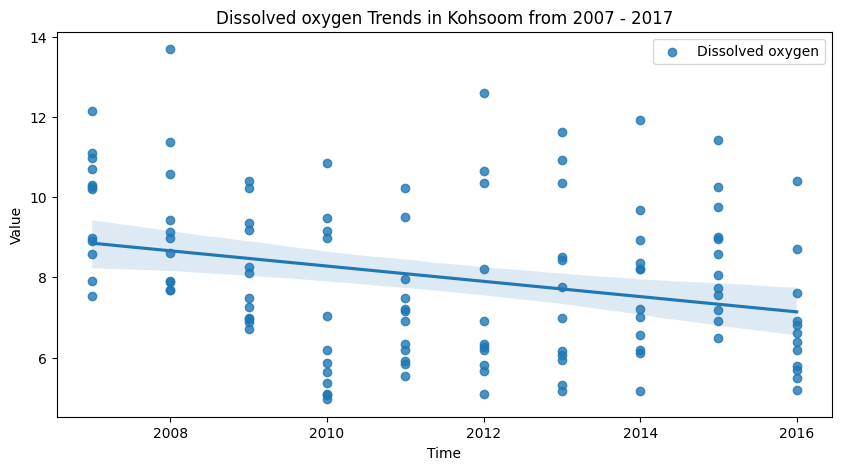

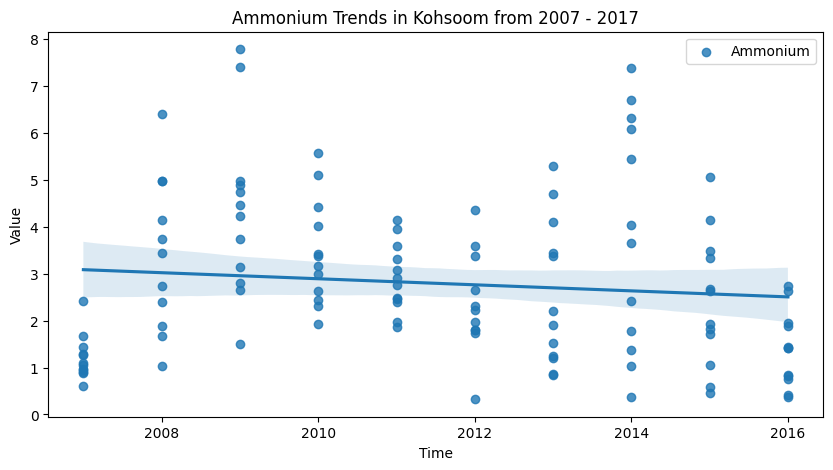

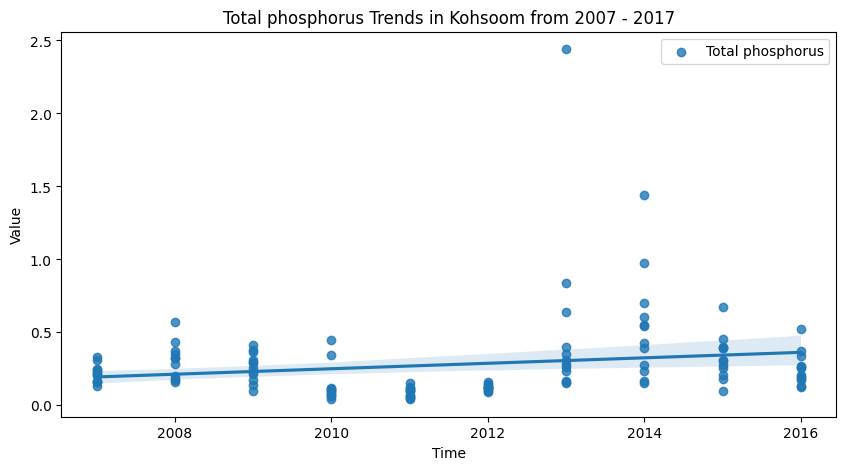

In [ ]:
# kohsoom data
kohsoom_data = df[(df.location == 'Kohsoom')]

# filter the dataframe to include only rows with sample dates between 2007 and 2017
kohsoom_df = kohsoom_data[(kohsoom_data['sample date'].dt.year >= 2007) & (kohsoom_data['sample date'].dt.year <= 2017)]

# chemicals of interest
chemicals = ['Methylosmoline', 'Arsenic', 'Fecal coliforms', 'Oxygen saturation', 'Dissolved oxygen', 'Ammonium', 'Total phosphorus']

dfs = []
for chemical in chemicals:
    dfs.append(kohsoom_df[kohsoom_df['measure'] == chemical])

sns.set_palette("tab20")
    
for i in range(len(dfs)):
    plt.figure(figsize=(10,5))
    ax = sns.regplot(x = dfs[i]['sample date'].dt.year, y=dfs[i]['value'], label = chemicals[i])
    ax.set_title(chemicals[i] + ' Trends in Kohsoom from 2007 - 2017')
    ax.legend()
    ax.set_xlabel("Time")
    ax.set_ylabel("Value")
    plt.show()

Increase: Methysolomine, Ammonium, Fecal Coliforms
Decrease: Oxygen Saturation, Dissolved Oxygens

The reduction in oxygen levels and increase in methylsolomine, ammonium, and fecal coliforms show evidence of contamination in Kohsoom.

### Line Plot of Water Temperature Vs Time trends in locations

Obsering the water temperatures at various sites could be insightful into the potential contaimination of the water. This is due to the possibility that waste that was held at lower temperature was dumped at this site. Here we plotted the water temperature measured at each sight over the course of several years. 

# Interactive Plot #5

In [ ]:
# water vs temperatures 2007 to 2017
df_water = df[(df.measure == 'Water temperature')]

# filter the dataframe to include only rows with sample dates between 2010 and 2017
df_water = df_water[(df_water['sample date'].dt.year >= 2007) & (df_water['sample date'].dt.year <= 2017)]


In [ ]:
# zoom filter
zoom = alt.selection_interval(bind='scales', encodings=['x', 'y'])


# create a dropdown menu for location selection
location_dropdown = alt.binding_select(options=list(df_water['location'].unique()), name='Location: ')
location_select = alt.selection_single(fields=['location'], bind=location_dropdown)

# create the main line chart
water_chart = alt.Chart(df_water).mark_line().encode(
    x='sample date:T',
    y=alt.Y('value:Q', scale = alt.Scale(domain=(0,100))),
    color=alt.Color("location:N", scale=alt.Scale(scheme='tableau20')),
    opacity=alt.condition(location_select, alt.value(1), alt.value(0.1))).add_selection(location_select).add_selection(zoom)

# add chart title
water_chart = water_chart.properties(
    title="Water Temperature vs Sample Date (2007 - 2017)"
)


# filter data for Methylosmoline
meth_df = df[(df["measure"] == "Methylosmoline") & 
               (df['sample date'].dt.year >= 2007) & 
               (df['sample date'].dt.year <= 2017)]


# zoom selection
zoom = alt.selection_interval(bind='scales', encodings=['x'])

# create scatter plot
scatter_plot = alt.Chart(meth_df).mark_circle().encode(
    x="sample date:T",
    y="value:Q",
    color=alt.Color("location:N", scale=alt.Scale(scheme='tableau20')),
    opacity=alt.condition(location_select, alt.value(1), alt.value(0.1)),
    tooltip=["location", "sample date", alt.Tooltip("value", format=".2f")]
).properties(
    width=400,
    height=300,
    title="Methylosmoline Concentration vs Time by Location"
).add_selection(location_select)

line_plot = alt.Chart(meth_df).mark_line().encode(
    x="sample date:T",
    y="value:Q",
    color=alt.Color("location:N", scale=alt.Scale(scheme='tableau20')),
    opacity=alt.condition(location_select, alt.value(1), alt.value(0.1)),
    tooltip=["location", "sample date", alt.Tooltip("value", format=".2f")]
).properties(
    width=400,
    height=300,
    title="Methylosmoline Concentration vs Time by Location"
).add_selection(zoom).transform_filter(location_select)

both = scatter_plot + line_plot

In [ ]:
# display both plotss
water_chart | both

alt.HConcatChart(...)

It appears that there may be inaccuracies in the water temperature measurements at Chai, as they have frequently shown temperatures lower than historical averages over the past year. One possible explanation for this discrepancy is that waste held at a lower temperature was dumped at the site. However, there are no other significant signs of contamination at Chai (no significant increase in methysolomine as showed in the previous plot).

# Conclusion

There is evidence of contamination around Kohsoom with the increase in Methysolomine, Ammonium, and Fecal Chloriforms in recent years, as well as decreases in the Oxygen Saturation levels and the Dissolved Oxygen levels.

From the measurements vs time plot, we can see that more testing is needed in several locations like Achara and Decha.

Additional testing should be done in Kohsoom and in Somchair, which showed evidence of methylsolomine, as these areas need more observations. Also, increasing testing in locations like Achara and Decha would be necessary.

